# Self-Driving Car Engineer Nanodegree

## Deep Learning

## Project: Build a Traffic Sign Recognition Classifier

---
## Step 0: Load The Data

In [16]:
import pickle

# TODO: Fill this in based on where you saved the training and testing data
training_file = r"C:\Users\avion105\Documents\SDC\p2-traffic-signs\traffic-sign-classifier-project\traffic-signs-data\train.p"
validation_file= r"C:\Users\avion105\Documents\SDC\p2-traffic-signs\traffic-sign-classifier-project\traffic-signs-data\valid.p"
testing_file = r"C:\Users\avion105\Documents\SDC\p2-traffic-signs\traffic-sign-classifier-project\traffic-signs-data\test.p"

with open(training_file, mode='rb') as f:
    train = pickle.load(f)
with open(validation_file, mode='rb') as f:
    valid = pickle.load(f)
with open(testing_file, mode='rb') as f:
    test = pickle.load(f)

In [2]:
X_train, y_train = train['features'], train['labels']
X_valid, y_valid = valid['features'], valid['labels']
X_test, y_test = test['features'], test['labels']

---

## Step 1: Dataset Summary & Exploration

The pickled data is a dictionary with 4 key/value pairs:

- `'features'` is a 4D array containing raw pixel data of the traffic sign images, (num examples, width, height, channels).
- `'labels'` is a 1D array containing the label/class id of the traffic sign. The file `signnames.csv` contains id -> name mappings for each id.
- `'sizes'` is a list containing tuples, (width, height) representing the the original width and height the image.
- `'coords'` is a list containing tuples, (x1, y1, x2, y2) representing coordinates of a bounding box around the sign in the image. **THESE COORDINATES ASSUME THE ORIGINAL IMAGE. THE PICKLED DATA CONTAINS RESIZED VERSIONS (32 by 32) OF THESE IMAGES**

In [216]:
# Number of training examples
n_train = len(X_train)

# Number of validation examples.
n_valid = len(X_valid)

# Number of testing examples.
n_test = len(X_test)

# Shape of a single image
image_shape = X_train[0].shape

# Number of unique classes/labels
n_classes = len(set(train['labels']))

print('Number of training examples =\t{:6,}'.format(n_train, align='>'))
print('Number of validation examples =\t{:6,}'.format(n_valid, align='>'))
print('Number of testing examples =\t{:6,}'.format(n_test, align='>'))
print("Image data shape =", image_shape)
print("Number of classes =", n_classes)

Number of training examples =	34,799
Number of validation examples =	 4,410
Number of testing examples =	12,630
Image data shape = (32, 32, 3)
Number of classes = 43


### Include exploratory visualization of the dataset

In [4]:
import matplotlib.pyplot as plt
%matplotlib inline

#### 'features' is a 4D array containing raw pixel data of the traffic sign images: `(num_examples, width, height, channels)`

#### Let's understand the structure of the 'features' Array
For example, if we want the three RGB values of pixel at `x_pos=2` and `y_pos=4` for `image=0` (the first image), we'll do the following:

In [5]:
train['features'][0][2][4]

array([27, 25, 22], dtype=uint8)

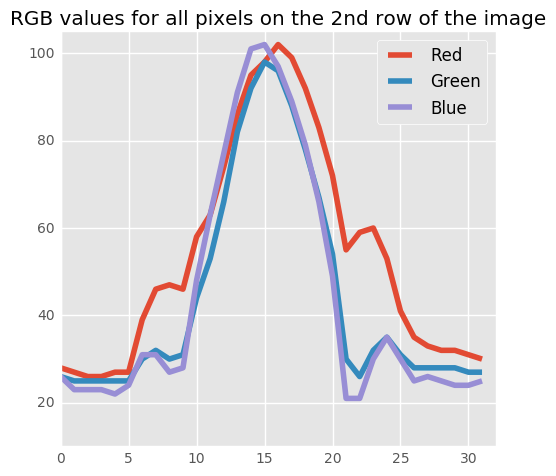

In [178]:
plt.style.use('ggplot')
plt.figure(figsize=(5,5))
plt.title('RGB values for all pixels on the 2nd row of the image')
plt.xlim(0,32)
plt.ylim(10,105)
plt.plot(train['features'][0][2]);
plt.legend(['Red','Green','Blue'])
plt.show();

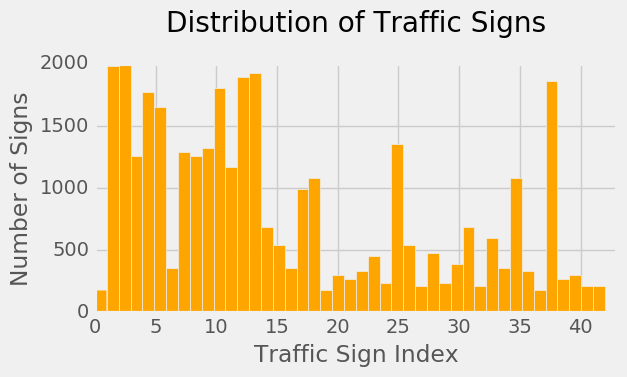

In [220]:
plt.style.use('fivethirtyeight')
plt.figure(figsize=(6,3))
plt.hist(y_train, bins=43, color='orange')
plt.title('Distribution of Traffic Signs', y=1.1)
plt.xlabel('Traffic Sign Index')
plt.ylabel('Number of Signs')
plt.xlim(0,43)
plt.ylim(0,2000)
plt.show();

### Read in the signs' CSV file and store it as a dictionary

In [12]:
import csv

with open('signnames.csv', 'r') as f:
    f.readline() #skip the header
    parts = []
    label_dict =  {}
    for line in f:
        parts = line.split(',')
        label_dict[int(parts[0])] = parts[1]

### Display a grid of randomly-chosen signs

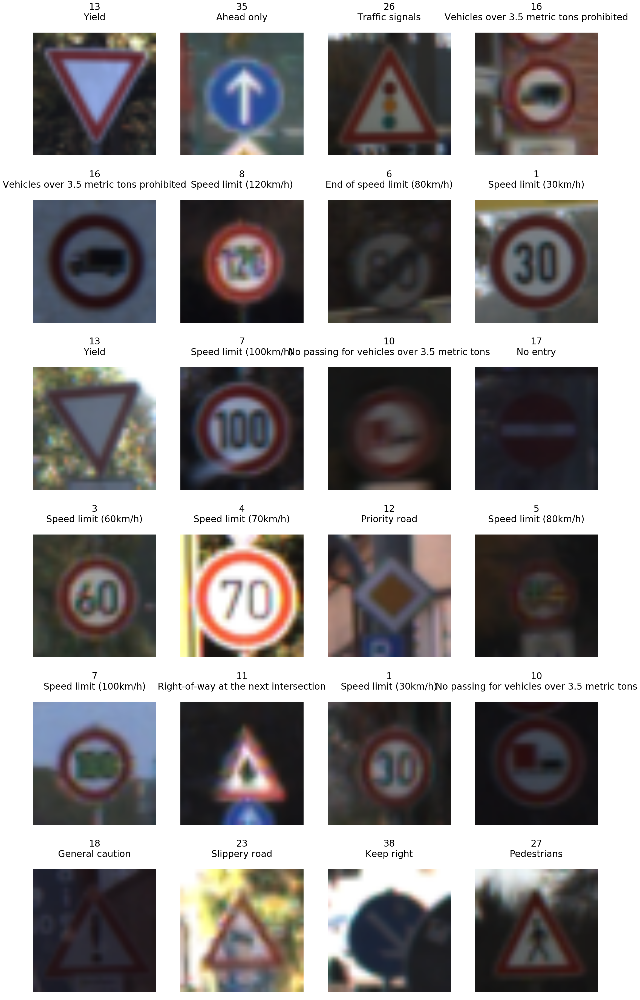

In [15]:
import random

plt.figure(figsize=(15,15))
plt.axis('off')
width =5
height = 5
for iter in range(24):
    plt.subplot(6,4,iter+1)
    index = random.randint(0, len(X_train))
    plt.tight_layout
    plt.axis('off')
    plt.title('{0}\n{1}'.format(y_train[index],label_dict.get(y_train[index])), y=1.0, fontsize=24)
    plt.subplots_adjust(top=2.5, right=1.5)
    plt.imshow(X_train[index])

### Normalize all of our images
Take every single Red, Green, and Blue pixel from every image and normailze its value between -1 and 1.

We want to do this as this greatly speeds up or optimazation part -- finding and applying a gradient during back-propagation will be much quicker.

In [19]:
import cv2
import numpy as np

def normalize(img):
    norm_img = np.zeros(img.shape)
    norm_img = cv2.normalize(img, norm_img, alpha=-1, beta=1, norm_type=cv2.NORM_MINMAX, dtype=cv2.CV_32F)
    return norm_img

In [20]:
from tqdm import tqdm

# keep a untouched set for presentation purposes later
X_test_pres = X_test
y_test_pres = y_test

X_train = [normalize(X_train[index]) for index in tqdm(range(len(X_train)))]
X_valid = [normalize(X_valid[index]) for index in range(len(X_valid))]
X_test = [normalize(X_test[index]) for index in range(len(X_test))]


100%|█████████████████████████████████| 34799/34799 [00:01<00:00, 33890.57it/s]


### Store the processed images in a pickle for later use

In [21]:
processed_images = {}
processed_images['X_train'] = X_train
processed_images['y_train'] = y_train
processed_images['X_valid'] = X_valid
processed_images['y_valid'] = y_valid
processed_images['X_test'] = X_test
processed_images['y_test'] = y_test
processed_images['X_test_pres'] = X_test_pres
processed_images['y_test_pres'] = y_test_pres
processed_images['labels_dict'] = label_dict

with open('processed_images', 'wb') as f:
    pickle.dump(processed_images, f)

----

## Step 2: Design and Test a Model Architecture

---

### We can start the notebook here for now on. It's over 200MB loaded into RAM
---


In [31]:
import pickle
with open('processed_images', 'rb') as f:
    processed_images = pickle.load(f)

### Shuffle Data
Let's shuffle the training data because there may be a lot of stop
signs, for example, at the beginning
which may skew the network more towards stopsigns.

In [22]:
from sklearn.utils import shuffle

X_train, y_train = shuffle(processed_images['X_train'], processed_images['y_train'])

In [23]:
X_validate = processed_images['X_valid']
y_validate = processed_images['y_valid']
X_test = processed_images['X_test']
y_test = processed_images['y_test']

# for presentation purposes
X_test_pres = processed_images['X_test_pres']
y_test_pres = processed_images['y_test_pres']

### Setup Tensor Flow

In [31]:
import tensorflow as tf

tf.reset_default_graph()

x = tf.placeholder(tf.float32, (None, 32, 32, 3), name='image_holder_0')
y = tf.placeholder(tf.int32, (None), name='label_holder_0')
one_hot_y = tf.one_hot(y,43)

EPOCH = 6
BATCH_SIZE = 128

# Value for Drop Out
keep_prob = tf.placeholder(tf.float32, name='keep_prob_0')

# Average and STDDEV values for normal distrubution
mu  = 0
sigma = 0.1

weights={
    'wc1' : tf.Variable(tf.truncated_normal(shape=(5,5,3,6), mean=mu, stddev=sigma)),
    'wc2' : tf.Variable(tf.truncated_normal(shape=(5,5,6,16), mean=mu, stddev=sigma)),
    'wd1' : tf.Variable(tf.truncated_normal(shape=(5*5*16, 120), mean=mu, stddev=sigma)),
    'wd2' : tf.Variable(tf.truncated_normal(shape=(120, 84), mean=mu, stddev=sigma)),
    'wout' : tf.Variable(tf.truncated_normal(shape=(84, 43), mean=mu, stddev=sigma))
}

biases={
    'bc1' : tf.Variable(tf.zeros(6)),
    'bc2' : tf.Variable(tf.zeros(16)),
    'bd1' : tf.Variable(tf.zeros(120)),
    'bd2' : tf.Variable(tf.zeros(84)),
    'bout' : tf.Variable(tf.zeros(43))
}

### LeNet-5 Model Architecture

In [29]:
from tensorflow.contrib.layers import flatten

def LeNet(x): 
    # where x will be a particular image (grabbing one pic out of a 4D array)
        
    # 1st Convolution --> from 32x32x3 to 28x28x6
    conv1 = tf.nn.conv2d(x, weights['wc1'], strides=[1,1,1,1], padding='VALID')
    conv1 += biases['bc1']
    conv1 = tf.nn.relu(conv1)
    
    # Max pool --> from 28x28x6 to 14x14x6
    conv1 = tf.nn.max_pool(conv1, ksize=[1,2,2,1], strides=[1,2,2,1], padding='VALID')
    
    # 2nd Convolution --> from 14x14x6 to 10x10x16
    conv2 = tf.nn.conv2d(conv1, weights['wc2'], strides=[1,1,1,1], padding='VALID')
    conv2 += biases['bc2']
    
    # Max pool from 10x10x16 to 5x5x16
    conv2 = tf.nn.max_pool(conv2, ksize=[1,2,2,1], strides=[1,2,2,1], padding='VALID')
    
    # Flatten from 5x5x16 to an array of 400
    fc0 = flatten(conv2)
    
    # 1st Fully Connected --> Input of 400 to Output of 120
    fc1 = tf.add(tf.matmul(fc0, weights['wd1']), biases['bd1'])
    fc1 = tf.nn.relu(fc1)
    fc1 = tf.nn.dropout(fc1, keep_prob)
    
    # 2nd Fully Connected --> Input of 120 to Output of 84
    fc2 = tf.add(tf.matmul(fc1, weights['wd2']), biases['bd2'])
    fc2 = tf.nn.relu(fc2)
    fc1 = tf.nn.dropout(fc1, keep_prob)
    
    # 3rd Fully Connected --> Input of 84 to Output of 43
    logits = tf.add(tf.matmul(fc2, weights['wout']), biases['bout'])
    
    return logits

### Set Optimization and Loss

In [33]:
learning_rate = 0.001

logits = LeNet(x)
cross_entropy = tf.nn.softmax_cross_entropy_with_logits(logits, one_hot_y)
loss_operation = tf.reduce_mean(cross_entropy)

optimizer = tf.train.AdamOptimizer(learning_rate=learning_rate)
training_operation = optimizer.minimize(loss_operation)

### Model Evaluation

In [35]:
# 'arg_max' returns the index of the largest value across a dimension of a tensor
# 'equal' returns a list of Boolean avlues
correction_prediction = tf.equal(tf.arg_max(logits, 1), tf.arg_max(one_hot_y,1))

# 'cast' casts Boolean values (in this case) to integers 0 and 1s
# 'reduce mean' computes the mean of the input's elements
accuracy_operation = tf.reduce_mean(tf.cast(correction_prediction, tf.float32))

def evalutate(X_data, y_data):
    num_examples = len(X_data)
    total_accuracy = 0
    sess = tf.get_default_session()
    for offset in range(0, num_examples, BATCH_SIZE):
        end = offset + BATCH_SIZE
        batch_x, batch_y = X_data[offset:end], y_data[offset:end]
        accuracy = sess.run(accuracy_operation, feed_dict={x: batch_x, y: batch_y, keep_prob: 1.0})
        total_accuracy += (accuracy * len(batch_x))
    return total_accuracy / num_examples

### Train the Model

In [37]:
saver = tf.train.Saver()
sess = tf.Session()

with tf.Session() as sess:
    sess.run(tf.global_variables_initializer())
    num_examples = len(X_train)
    
    print("Training the model....\n")
    for i in range(EPOCH):
        X_train, y_train = shuffle(X_train, y_train)
        for offset in range(0, num_examples, BATCH_SIZE):
            end = offset + BATCH_SIZE
            batch_x, batch_y = X_train[offset:end], y_train[offset:end]
            sess.run(training_operation, feed_dict={x: batch_x, y: batch_y, keep_prob: 0.5})
            
        validation_accuracy = evalutate(X_validate, y_validate)
        print("EPOCH {} ...".format(i+1))
        print("Validation Accuracy = {:.3f}\n".format(validation_accuracy))
    saver.save(sess, '.\\lenet_model\\')
    print("Model saved")

Training the model....

EPOCH 1 ...
Validation Accuracy = 0.833

EPOCH 2 ...
Validation Accuracy = 0.899

EPOCH 3 ...
Validation Accuracy = 0.919

EPOCH 4 ...
Validation Accuracy = 0.927

EPOCH 5 ...
Validation Accuracy = 0.932

EPOCH 6 ...
Validation Accuracy = 0.935

Model saved


---

## Step 3: Test the model on new images

Download at least five pictures of German traffic signs from the web and use the model to predict the traffic sign.

### Load, Clean and Output the hand-picked Images

Please note that extra test images were added that are not part of the 43 known traffic signs.
This is to test varying degrees of confidence when the model faces novel traffic signs.
However, when it comes to verifying the model's 'official' accuracy on hand-selected test images, only known traffic signs are used.

*official-test-images* = 7

*extra-test-images* = *official-test-images* + (two extra traffic signs) = 9

In [100]:
import os
import cv2
import numpy as np
import matplotlib.pyplot as plt

def load_clean_images(path):
    
    # Create a list of hand-picked test images
    _images_clean = []
    _images_clean_orig = []
    _images = os.listdir(path)
    
    for image in _images:

        # Read in an image
        if 'Thumbs.db' in image: continue
        _image = plt.imread(path + '/' + image)

        # Keep a list of the images before being normalized for the final presentation
        _images_clean_orig.append(_image)

        # Resize images
        _image = cv2.resize(_image, (32,32))

        # Normalize images
        _image = normalize(_image)
        
        # Add normalized images
        _images_clean.append(_image)
                           
    return np.array(_images_clean), np.array(_images_clean_orig), _images

images_clean = []
images_clean_orig = []
images_names = []
images_clean, images_clean_orig, images_names = load_clean_images('examples_from_google_with_extra_images/')

### Predict the Sign Type for Each Image

In [221]:
# Compute the softmax for each image we test
probs = tf.nn.softmax(LeNet(x))

with tf.Session() as sess:
    saver.restore(sess, '.\\lenet_model\\')
    
    # Return the predictions
    pred = sess.run(probs, feed_dict={x: images_clean, keep_prob: 1})
    print('Shape of prediction', pred.shape)
        
    # Get the indices of the Top 5 predictions
    labels = tf.nn.top_k(pred, k=5)
    print('\nIndices of the top 5 predictions\n'
          'Rows are each sign\n'
          'Columns are the predicted traffic sign\n\n', labels.indices.eval())
    
    # Get the probablitiy percentage of the Top 5 predictions
    print('\nSoftmax Probabilities (Confidence Percentages)\n'
           'of the top 5 predictions\n\n', labels.values.eval()) 
    
    # Store our test results
    labels_indices, labels_values = labels.indices.eval(), labels.values.eval()

Shape of prediction (9, 43)

Indices of the top 5 predictions
Rows are each sign
Columns are the predicted traffic sign

 [[20 30 28 41 23]
 [17  0  1 14  4]
 [10 42  9 11  7]
 [ 9 16 41 20 10]
 [ 9 41 36  5 16]
 [14 17  4  1 25]
 [17  1 31 20 40]
 [40 20 35 42 41]
 [ 1  2 13 17  4]]

Softmax Probabilities (Confidence Percentages)
of the top 5 predictions

 [[  8.84043396e-01   7.10559189e-02   4.02451903e-02   3.33655626e-03
    1.26682885e-03]
 [  9.99989748e-01   9.09301252e-06   1.14178431e-06   1.25466915e-09
    6.66614153e-10]
 [  9.99999523e-01   3.04578833e-07   1.39410446e-07   7.06624093e-09
    2.76569168e-09]
 [  9.99993801e-01   5.94869562e-06   1.53627425e-07   8.98122536e-08
    4.74871449e-08]
 [  9.12200153e-01   4.45838943e-02   1.36804571e-02   1.02201076e-02
    9.61114094e-03]
 [  9.60850120e-01   2.27153040e-02   1.21974507e-02   1.97363948e-03
    7.33407156e-04]
 [  9.97002304e-01   1.25963613e-03   8.95254896e-04   7.53824075e-04
    7.41098484e-05]
 [  9.9898

### Analyze Performance

Calculate the accuracy for at least 5 new images. 
For example, if the model predicted 1 out of 5 signs correctly, it's 20% accurate on these new images.


These will be the 7 official images the model will be tested on




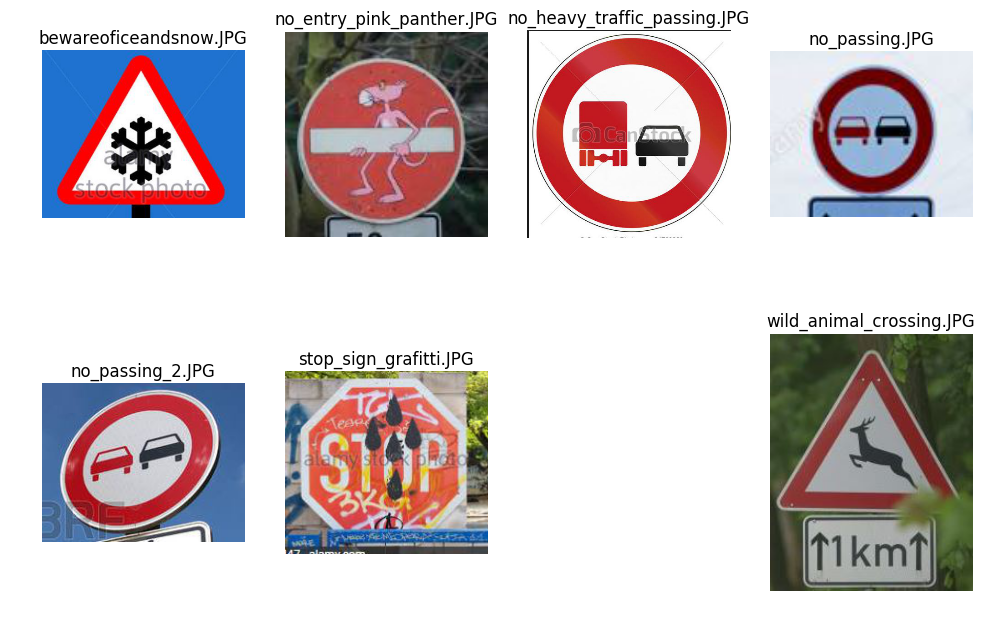

In [115]:
# Get image file names so we can display the test images
path = r'./examples_from_google//'
images = os.listdir(path)

# Initialize empty lists
X_test_my_images = []
y_test_my_images = []

# Load and clean test images. 
# Hard-code the correct sign label number for 'y_test_my_images' array
X_test_my_images, _, _ = load_clean_images('examples_from_google/')
y_test_my_images = np.array([30, 17, 10, 9, 9, 14, 31], dtype=np.int32)

# Display offical test images
print('\nThese will be the {0} official images the model will be tested on\n\n'.format(len(images)-1))

plt.figure(figsize=(12,12))

for iter, image in enumerate(images):
    
    # Read image file
    if 'Thumbs.db' in image: continue    
    _image = plt.imread(path + '/' + image)
    
    # Display image
    plt.subplot(3, 4, iter+1)
    plt.title(image)
    plt.axis('off')
    plt.imshow(_image)

plt.show()

### Calculate and Dispaly Accuracies

In [116]:
with tf.Session() as sess:
    
    saver.restore(sess, '.\\lenet_model\\')
    
    # My own Test Images
    validation_accuracy = evalutate(X_test_my_images, y_test_my_images)
    print("Accuracy for my Test Images = \t{:2.2f}%\n".format(validation_accuracy * 100))    
    
    # Training Accuracy
    validation_accuracy = evalutate(X_train, y_train)
    print("Accuracy for Training Images = \t{:2.2f}%\n".format(validation_accuracy * 100))
                                                           
    # Validation Accuracy
    validation_accuracy = evalutate(X_valid, y_valid)
    print("Accuracy for Validation Images = \t{:2.2f}%\n".format(validation_accuracy * 100))

    # Drum Roll Please .... Official Accuracy for Udacity's Test Images
    validation_accuracy = evalutate(X_test, y_test)
    print("Accuracy for Udacity's Test Images = \t{:2.2f}%\n".format(validation_accuracy * 100))

Accuracy for my Test Images = 	71.43%

Accuracy for Training Images = 	98.89%

Accuracy for Validation Images = 	93.51%

Accuracy for Udacity's Test Images = 	92.28%



### Output Top 5 Softmax Probabilities For Each Image Found on the Web

#### Create a list of example images that correspond to the predicted output of LeNet-5

In [117]:
pred_examples = []

# Loop through label_indices and extract an example image from the list X_test_pres
# labels_indices is a 2D matrix that holds the label number of the signs (0-43)
for row in labels_indices:
    for col in row:
        
        # grab the index from y_validation whose value matches 'col'
        index = np.where(y_test_pres == col)[0][0]
        
        # append the image from x_validation whose index pairs with 'index'
        pred_examples.append(X_test_pres[index])

### Plot the Model's predictions
#### THis will include not only the official test images, but also extra traffic signs  the model was not trained on as mentioned previously

In [225]:
def plot_legend():
    # plot a legend
    example = plt.imread('./examples_from_google/no_passing.jpg')
    plt.figure(figsize=(2,2))
    plt.title('Sign Label\nSoftmax Probability')
    plt.axis('off')
    plt.imshow(example)

### Create a nest for-loop to plot our test and predicted images like so...

```
--------------------------------------------------------
<test image 1> | <1st prediction> | <2nd prediction> ...
--------------------------------------------------------
<test image 2> | <1st prediction> | <2nd prediction> ...
--------------------------------------------------------
<test image 3> | <1st prediction> | <2nd prediction> ...
--------------------------------------------------------
.
.
.
```

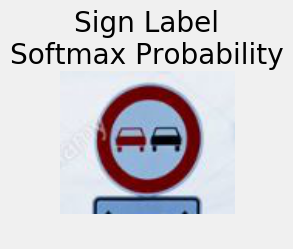

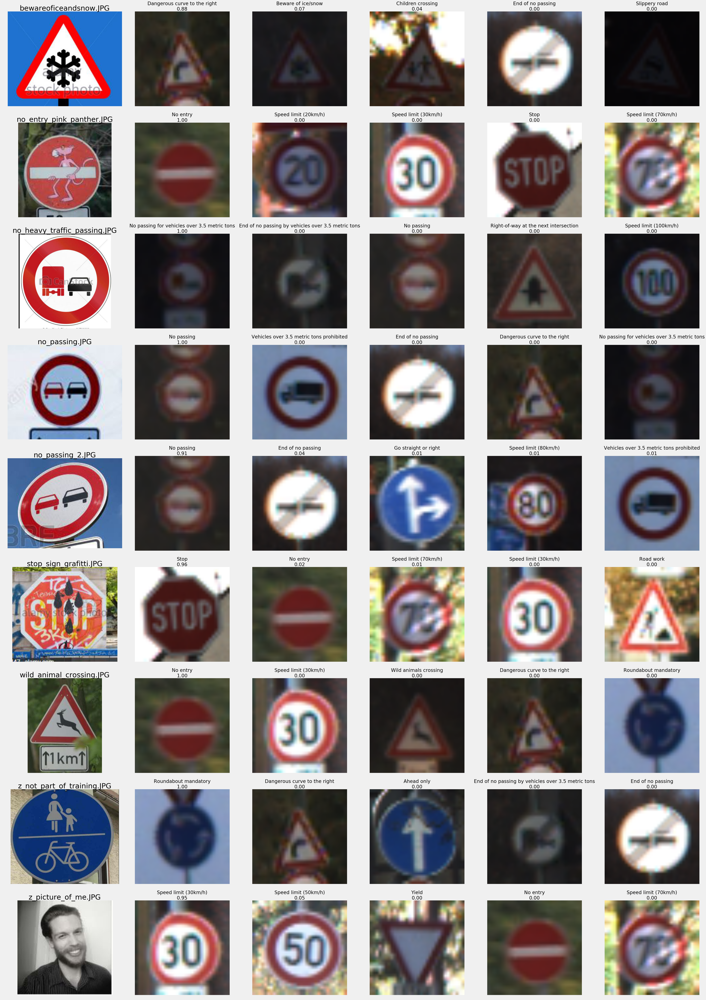

In [226]:
# Clean plots, figures
plt.close()
plt.clf()

# Plot simple legend
plot_legend()

# Setup main plot params
plt.figure(figsize=(50,70))
width = len(labels_indices[0]) 
height = len(images_clean_orig)

images_names = os.listdir('examples_from_google_with_extra_images/')

for col_i, image in enumerate(images_clean_orig):
        
    # Calculate index value for first-column images
    col_first = col_i*width + col_i + 1
    
    # Plot only first colum images
    plt.subplot(height, width+1, col_first)
    plt.axis('off')
    plt.tight_layout()
    title = images_names[col_i]
    plt.title('{0!s}'.format(title), fontsize=36)   
    plt.imshow(image)
    
    # while on the same row, plot the top five predictions given by LeNet-5
    for iter in range(len(labels_indices[0])):
             
        index_grid = col_first + iter + 1
        index_pred = col_first - col_i + iter - 1
        sign_label_index = labels_indices[col_i][iter]
        
        # Plot row images
        plt.subplot(height, width+1, index_grid)
        plt.axis('off')
        plt.tight_layout()        
        plt.title('{0!s}{1:2.2f}'.format(
                    label_dict[sign_label_index],
                    labels_values[col_i][iter]
                    ),
                    fontsize=24
        )
        plt.imshow(pred_examples[index_pred]) 

plt.show()